In [2]:
import pandas as pd
import sys
sys.path.append('../gtm/')
from corpus import GTMCorpus
from gtm_customized import GTM
import pickle as p
import os

In [3]:
def load_examples(language='en'):
  if language == 'en' or language == 'zh':
    df = pd.read_csv('../data/wiki_shorts/{}/corpus/docs.txt'.format(language), header=None, delimiter='\t')
    df.columns = ['doc_clean']
  else:
    # read english and chinese docs
    df_en = pd.read_csv('../data/wiki_shorts/en/corpus/docs.txt', header=None, delimiter='\t')
    df_en.columns = ['doc_clean']
    df_zh = pd.read_csv('../data/wiki_shorts/zh/corpus/docs.txt', header=None, delimiter='\t')
    df_zh.columns = ['doc_clean']
    # merge english and chinese docs
    df = pd.concat([df_en, df_zh], ignore_index=True)
  # df = df.head(1000)
  return df

In [4]:
def create_dataset(language='en'):
  if not os.path.exists('train_dataset_intfloat-e5-large2-{}.pkl'.format(language)):
    print('Loading examples for {}'.format(language))
    df = load_examples(language)
    train_dataset = GTMCorpus(
      df,
      count_words=True,
      embeddings_type='SentenceTransformer',
      sbert_model_to_load='intfloat/multilingual-e5-large',
      content=None,
      prevalence=None,
      batch_size=64,
      max_seq_length=512)
    print('Saving train_dataset_intfloat-e5-large2-{}.pkl'.format(language))
    with open('train_dataset_intfloat-e5-large2-{}.pkl'.format(language), 'wb') as f:
      p.dump(train_dataset, f)
  else:
    with open('train_dataset_intfloat-e5-large2-{}.pkl'.format(language), 'rb') as f:
      train_dataset = p.load(f)
  return train_dataset

In [5]:
train_dataset = create_dataset('en-zh')

In [47]:
tm = GTM(
  train_dataset,
  n_topics=6,
  doc_topic_prior='dirichlet', # logistic_normal, dirichlet
  alpha=0.02,
  update_prior=False,
  encoder_input='embeddings', # 'bow', 'embeddings'
  decoder_output='embeddings',
  encoder_hidden_layers=[], # structure of the encoder neural net
  decoder_hidden_layers=[256], # structure of the decoder neural net
  encoder_bias=True,
  decoder_bias=True,
  num_epochs=0,
  print_every=10000,
  dropout=0.0,
  learning_rate=0.01,
  log_every=1,
  w_prior=None,
  batch_size=512,
  patience=5,
	save_path='../ckpt2/task2',
  ckpt='../ckpt2/task2/best_model.ckpt'
)

Loading checkpoint from ../ckpt2/task2/best_model.ckpt
OrderedDict([('encoder.enc_0.weight', tensor([[-2.3514,  3.4950,  0.8091,  ..., -2.3972,  0.7527,  0.6941],
        [-0.1449, -3.6536, -1.8245,  ..., -3.8972,  2.2549, -3.7199],
        [-0.0875, -0.8928,  2.5677,  ...,  3.4933, -1.3222, -0.7625],
        [ 2.1953,  0.7703, -0.1055,  ...,  0.1613, -1.5612,  1.8962],
        [-0.9476,  2.1583, -1.2662,  ..., -1.0833, -0.6462, -0.2641],
        [ 1.5370, -2.3998, -1.1222,  ...,  2.4661,  0.7815,  2.9037]],
       device='mps:0')), ('encoder.enc_0.bias', tensor([ 0.1259,  0.1061,  0.0057,  0.0377, -0.1467, -0.0246], device='mps:0')), ('decoder.dec_0.weight', tensor([[ 0.1488,  0.1044, -0.0822,  0.2676, -0.1772,  0.3212],
        [-0.0461, -0.0044,  0.0863, -0.1275, -0.1428, -0.2481],
        [-0.1708,  0.2020,  0.3184,  0.2385,  0.0777, -0.1458],
        ...,
        [-0.1053, -0.0883, -0.0448, -0.3038, -0.0214, -0.3180],
        [-0.0089,  0.3430, -0.2328,  0.1672, -0.1663,  0.2532],

In [48]:
import numpy as np
def inspect(tm, ds):
  doc_topic_distribution = tm.get_doc_topic_distribution(ds)

  print('Number of documents per topic')
  print('Topic 0: {}'.format((doc_topic_distribution.argmax(-1) == 0).sum()))
  print('Topic 1: {}'.format((doc_topic_distribution.argmax(-1) == 1).sum()))
  print('Topic 2: {}'.format((doc_topic_distribution.argmax(-1) == 2).sum()))
  print('Topic 3: {}'.format((doc_topic_distribution.argmax(-1) == 3).sum()))
  print('Topic 4: {}'.format((doc_topic_distribution.argmax(-1) == 4).sum()))
  print('Topic 5: {}'.format((doc_topic_distribution.argmax(-1) == 5).sum()))

  # show five random documents per topic
  for topic in range(tm.n_topics):
    print('Topic {}'.format(topic))
    print('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
    for i in np.random.choice(np.where(doc_topic_distribution.argmax(-1) == topic)[0], 5):
      print('='*50)
      print(ds.df.iloc[i]['doc_clean'])
      print('----------')
      print('Topic distribution = {}'.format(doc_topic_distribution[i]))

In [49]:
inspect(tm, train_dataset)

Number of documents per topic
Topic 0: 3401
Topic 1: 3465
Topic 2: 3647
Topic 3: 3478
Topic 4: 3873
Topic 5: 3314
Topic 0
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
咸肉 泛指 用 食盐 保存 和 调味 的 肉类 主要 是 猪肉 。 一般 不 包括 同时 采用 其他 保存 方法 的 比如 腊肉 风干 熏肉 包括 烟 肉 加热 等 。 举例 咸肉 咸 猪肉 火腿 猪腿肉 咸肉 菜饭 苏南浙 北 上海 一带 的 特色 食物 。 粗盐腌牛肉 cornedbeef 牛肉 咸鱼 咸虾
----------
Topic distribution = [9.9998772e-01 1.5235175e-07 4.2354773e-07 1.4776460e-08 6.4240305e-07
 1.1010856e-05]
驼鹿 （ Alces alces ） ， 是 世界 上 最大 的 鹿科 动物 ， 是 驼鹿 属下 的 唯一 种 。 以 雄性 的 掌形 鹿角 为 特征 。 在 中国 为 国家 二 级 保护 动物 。 名称 驼鹿 的 名称 取 意于 其肩 高于臀 ， 与 骆驼 相似 。 又 称 堪达罕 、 犴达罕 、 犴 ， 均 来自 满语 “ ᡴᠠᠨᡩᠠᡥᠠᠨ ” （ 转写 ： kandahan ） 。 驼鹿 在 北美洲 称为 「 moose 」 （ 源于 东阿布纳基语 的 「 moz 」 ） ， 而 在 欧洲 称为 「 elk 」 （ 「 elk 」 在 北美洲 被 用 来 称唿 加拿大 马鹿 ） 。
----------
Topic distribution = [9.9956614e-01 9.4927200e-06 1.1339233e-06 4.6444114e-07 2.5093282e-04
 1.7176043e-04]
弄蝶 （ Silver-spotted Skipper ， 学名 ： Hesperia comma ） 是 弄蝶 属 中 的 一 种 弄蝶 ， 也 是 弄蝶 的 模式 种 。 寄主 植物 为 禾本科 的 羊茅 。 分佈 主要 分佈 在 欧洲

In [50]:
# write a function to write all examples of the same topic to a file
def write_topic_to_file(topic_id, ds, doc_topic_distribution, path):
  with open(path, 'w') as f:
    for i in np.where(doc_topic_distribution.argmax(-1) == topic_id)[0]:
      f.write(ds.df.iloc[i]['doc_clean'] + '\n')

In [51]:
doc_topic_distribution = tm.get_doc_topic_distribution(train_dataset)

In [52]:
import os
if not os.path.exists('../data/task2'):
  os.makedirs('../data/task2')

In [53]:
write_topic_to_file(0, train_dataset, doc_topic_distribution, '../data/task2/topic_0.txt')
write_topic_to_file(1, train_dataset, doc_topic_distribution, '../data/task2/topic_1.txt')
write_topic_to_file(2, train_dataset, doc_topic_distribution, '../data/task2/topic_2.txt')
write_topic_to_file(3, train_dataset, doc_topic_distribution, '../data/task2/topic_3.txt')
write_topic_to_file(4, train_dataset, doc_topic_distribution, '../data/task2/topic_4.txt')
write_topic_to_file(5, train_dataset, doc_topic_distribution, '../data/task2/topic_5.txt')

In [54]:
# read labels
def read_labels(language='en'):
	with open('../data/wiki_shorts/{}/corpus/docs.txt'.format(language), 'r') as file:
		docs = file.readlines()
	with open('../data/wiki_shorts/{}/labels.txt'.format(language), 'r') as file:
		labels = file.readlines()
	
	# one to one mapping of docs to labels
	doc2label = {}
	for i in range(len(docs)):
		doc2label[docs[i][:100].strip()] = int(labels[i].strip())
	return doc2label

In [55]:
doc2label_en = read_labels('en')
doc2label_zh = read_labels('zh')

In [56]:
# for each topic, find its majority label
from collections import defaultdict

def find_majority_label(topic):
  label2cnt = defaultdict(int)
  labels = []
  with open('../data/task2/topic_{}.txt'.format(topic), 'r') as file:
    lines = file.readlines()
    for line in lines:
      k = line[:100].strip()
      if k in doc2label_en:
        v = doc2label_en[k]
      else:
        v = doc2label_zh[k]
      label2cnt[v] += 1
      labels.append(v)
  predicted = max(label2cnt, key=lambda k: label2cnt[k])
  return label2cnt, labels, predicted

In [57]:
_, labels_0, predicted_0 = find_majority_label(0)
_, labels_1, predicted_1 = find_majority_label(1)
_, labels_2, predicted_2 = find_majority_label(2)
_, labels_3, predicted_3 = find_majority_label(3)
_, labels_4, predicted_4 = find_majority_label(4)
_, labels_5, predicted_5 = find_majority_label(5)

In [58]:
print(predicted_0, predicted_1, predicted_2, predicted_3, predicted_4, predicted_5)

2 4 5 1 0 3


In [59]:
final_labels = labels_0 + labels_1 + labels_2 + labels_3 + labels_4 + labels_5
len(final_labels)

21178

In [60]:
final_pred = [predicted_0] * len(labels_0) + [predicted_1] * len(labels_1) + [predicted_2] * len(labels_2) + [
  predicted_3] * len(labels_3) + [predicted_4] * len(labels_4) + [predicted_5] * len(labels_5)
len(final_pred)

21178

In [61]:
model_pred = [0]*len(labels_0) + [1]*len(labels_1) + [2]*len(labels_2) + [3]*len(labels_3) + [4]*len(labels_4) + [5]*len(labels_5)
len(model_pred)

21178

In [62]:
from sklearn.metrics import f1_score, accuracy_score, adjusted_rand_score

f1_macro = f1_score(y_true=final_labels, y_pred=final_pred, average='macro')
f1_micro = f1_score(y_true=final_labels, y_pred=final_pred, average='micro')
acc = accuracy_score(y_true=final_labels, y_pred=final_pred)
ars = adjusted_rand_score(labels_true=final_labels, labels_pred=model_pred)

In [63]:
print('f1_macro = {}'.format(f1_macro))
print('f1_micro = {}'.format(f1_micro))
print('acc = {}'.format(acc))
print('ars = {}'.format(ars))

f1_macro = 0.5133169509566651
f1_micro = 0.5128907356690906
acc = 0.5128907356690906
ars = 0.31699328050569153


In [40]:
wordcloud_args={'background_color': 'white',
                'font_path': '/System/Library/Fonts/Supplemental/Songti.ttc',
                'min_font_size': 10,
                'max_font_size': 100,
                'max_words': 1000,
                'height': 1000,
                'width': 2000}

{'1525': 0.0011897264048457146, '1802年': 0.0010811937972903252, '1821': 0.0010703230509534478, '1982年': 0.0010691226925700903, '000余万': 0.001055176486261189, '12亿': 0.0010519310599192977, '079': 0.0010505716782063246, '05年': 0.001048559439368546, '144': 0.0010478978510946035, '1856': 0.0010476611787453294, '1787年': 0.001044275937601924, '1千万': 0.0010427742963656783, '1804': 0.00104231177829206, '19世纪': 0.0010419572936370969, '153': 0.0010404583299532533, '156万': 0.0010399396996945143, '1816年': 0.001037950743921101, '10th週': 0.001035815803334117, '11万': 0.0010332842357456684, '180三': 0.0010330919176340103, '1150年': 0.0010330172954127192, '199798': 0.0010328128701075912, '1904': 0.001032634754665196, '1920年代': 0.0010323062306270003, '1003': 0.0010293913073837757, '1945': 0.0010293801315128803, '1852': 0.0010270338971167803, '1948': 0.0010264839511364698, '19日': 0.001025272416882217, '1703年': 0.001025162753649056, '130万': 0.0010249550687149167, '1995年': 0.001024729572236538, '1770年': 0.00

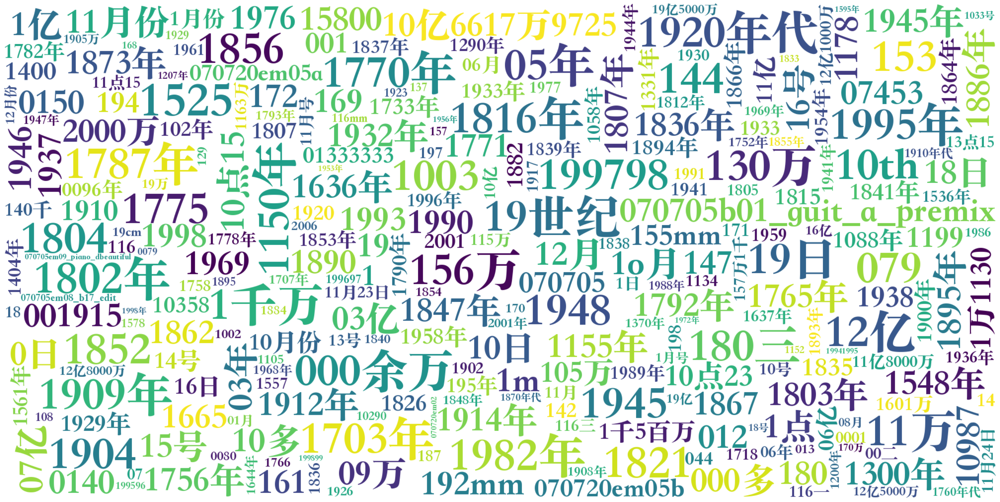

In [41]:
tm.plot_wordcloud(topic_id=0, topK=1000, output_path='../data/task2/topic_0.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'1525': 0.0012008545454591513, '12亿': 0.0010878987377509475, '1802年': 0.0010713690426200628, '1982年': 0.0010606184368953109, '1821': 0.0010571677703410387, '05年': 0.0010524775134399533, '144': 0.0010478534968569875, '000余万': 0.0010418425081297755, '15800': 0.0010402780026197433, '1月号': 0.0010391753166913986, '000多': 0.0010390569223091006, '1856': 0.001036380184814334, '1804': 0.0010342090390622616, '1o月': 0.0010341525776311755, '153': 0.0010340610751882195, '1771': 0.0010332330130040646, '1770年': 0.0010332157835364342, '1866年': 0.0010311848018318415, '13亿3000万': 0.0010307959746569395, '140千': 0.0010307744378224015, '172': 0.0010298921260982752, '1956年': 0.0010293073719367385, '199798': 0.001028929720632732, '1993': 0.0010287172626703978, '1948': 0.0010286129545420408, '187': 0.0010284919990226626, '1775': 0.0010284269228577614, '10多': 0.0010283015435561538, '10点15': 0.0010282860603183508, '06年': 0.0010278855916112661, '1178': 0.0010275919921696186, '1787年': 0.0010274626547470689, '190

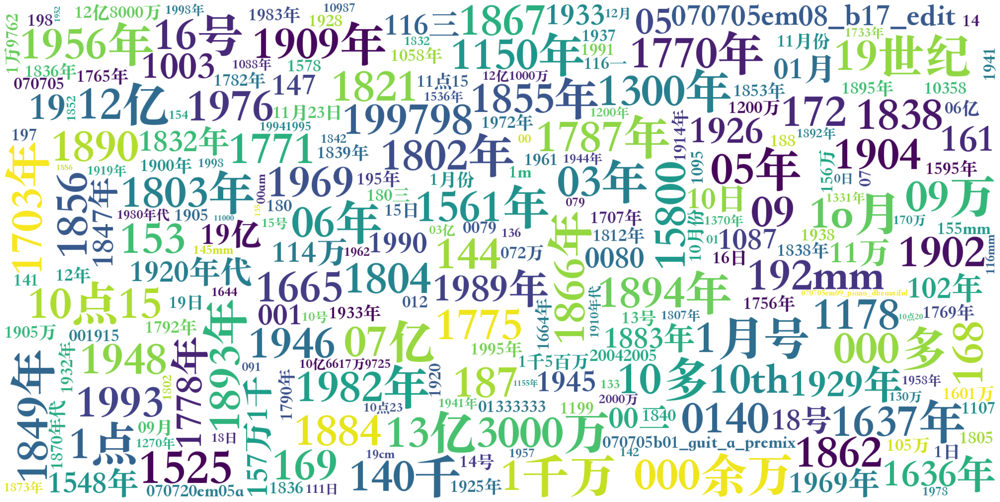

In [42]:
tm.plot_wordcloud(topic_id=1, topK=1000, output_path='../data/task2/topic_1.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'1525': 0.0012026209151372313, '12亿': 0.001088533434085548, '1802年': 0.0010693997610360384, '1982年': 0.0010644594440236688, '000余万': 0.0010537293273955584, '144': 0.00105279718991369, '1770年': 0.0010458978358656168, '1976': 0.001045774552039802, '1821': 0.0010439991019666195, '153': 0.0010428277309983969, '11月23日': 0.00103696808218956, '16号': 0.0010368155781179667, '199798': 0.0010364250047132373, '05年': 0.0010355409467592835, '13亿3000万': 0.0010355135891586542, '1856': 0.0010348082287237048, '000多': 0.0010346684139221907, '1804': 0.0010341653833165765, '1703年': 0.0010338516440242529, '15800': 0.0010335876140743494, '1787年': 0.00103343918453902, '1862': 0.00103234953712672, '1867': 0.0010296449763700366, '1月号': 0.0010293627856299281, '1883年': 0.0010291715152561665, '1150年': 0.0010264714946970344, '172': 0.001025921548716724, '180三': 0.0010256784735247493, '19世纪': 0.001025586505420506, '1o月': 0.0010252280626446009, '1893年': 0.0010247677564620972, '169': 0.0010245190933346748, '1948': 0.

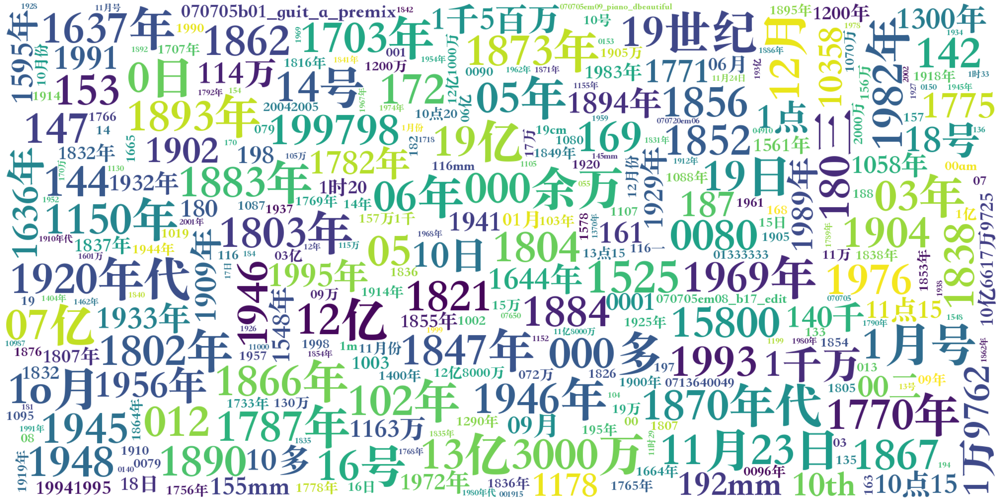

In [43]:
tm.plot_wordcloud(topic_id=2, topK=1000, output_path='../data/task2/topic_2.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'1525': 0.0012047715717926621, '12亿': 0.001076958840712905, '1802年': 0.0010758866555988789, '05年': 0.0010587784927338362, '1821': 0.0010566916316747665, '1982年': 0.0010551915038377047, '15800': 0.0010460608173161745, '144': 0.0010454264702275395, '000余万': 0.0010420094477012753, '1866年': 0.0010363198816776276, '1637年': 0.0010359392035752535, '1969年': 0.0010357423452660441, '1月号': 0.001035595079883933, '1862': 0.001032960950396955, '19世纪': 0.0010315015679225326, '1787年': 0.001031228224746883, '06年': 0.0010307844495400786, '169': 0.0010306208860129118, '05': 0.0010303885210305452, '1770年': 0.0010301576694473624, '1595年': 0.001030061044730246, '199798': 0.0010300233261659741, '1993': 0.001029019826091826, '1856': 0.00102856638841331, '172': 0.0010266628814861178, '1804': 0.0010258557740598917, '1902': 0.0010255194501951337, '1775': 0.001025264267809689, '1946': 0.0010252208448946476, '187': 0.0010248355101794004, '000多': 0.0010248206090182066, '09万': 0.001024326542392373, '16号': 0.0010241

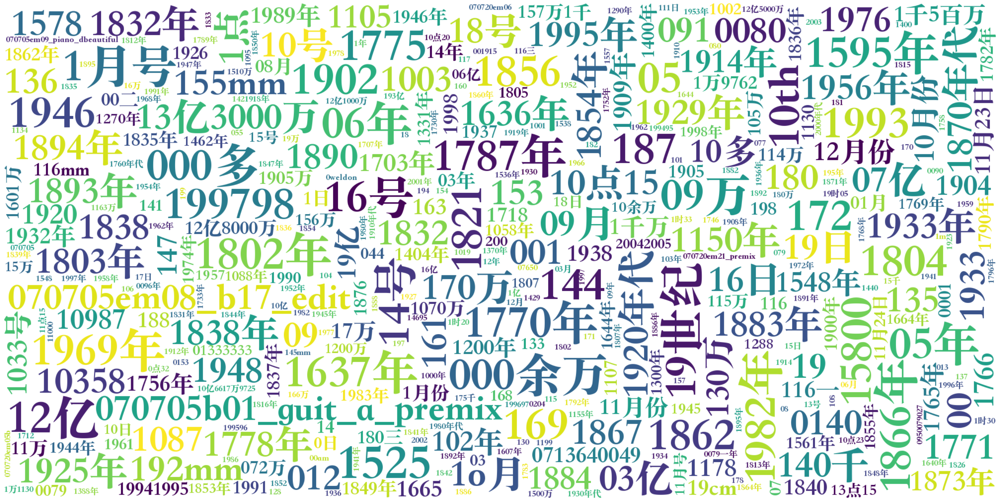

In [44]:
tm.plot_wordcloud(topic_id=3, topK=1000, output_path='../data/task2/topic_3.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'1525': 0.0011946463491767645, '1802年': 0.001082745031453669, '1821': 0.0010712076909840107, '12亿': 0.0010618518572300673, '05年': 0.0010519144125282764, '10th週': 0.0010512769222259521, '19世纪': 0.0010484864469617605, '1982年': 0.0010434590512886643, '144': 0.00104342692065984, '000余万': 0.0010429276153445244, '1945': 0.0010413004783913493, '1150年': 0.00103816669434309, '199798': 0.0010375793790444732, '1904': 0.0010360470041632652, '1775': 0.0010343583999201655, '147': 0.0010338654974475503, '1771': 0.0010337266139686108, '1千万': 0.0010332452366128564, '153': 0.0010331330122426152, '169': 0.0010322133312001824, '1787年': 0.0010316092520952225, '1804': 0.0010315702529624104, '1792年': 0.0010301654692739248, '03亿': 0.001029317849315703, '1948': 0.0010291142389178276, '070705b01_guit_a_premix': 0.0010288400808349252, '1803年': 0.001028172904625535, '0150': 0.001027968479320407, '1200万': 0.0010273763909935951, '180': 0.0010265896562486887, '1909年': 0.00102654576767236, '1665': 0.0010263439035043

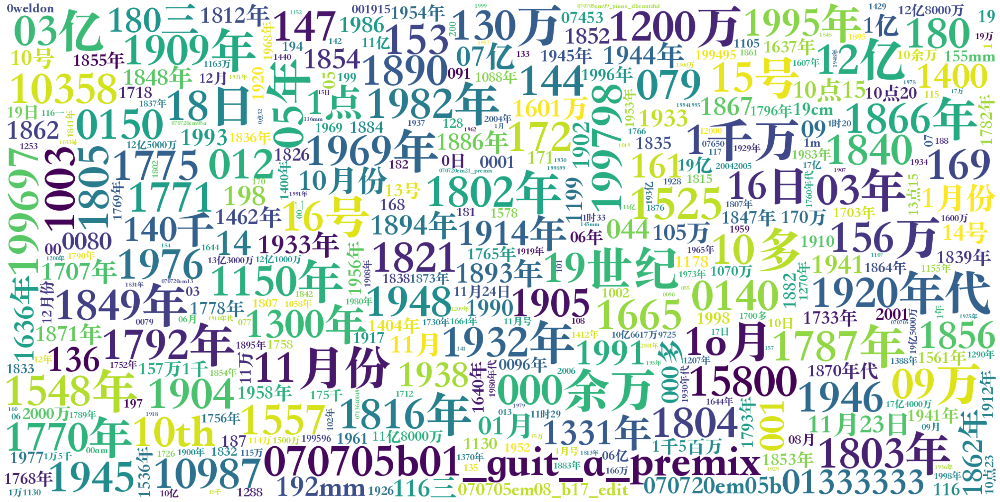

In [45]:
tm.plot_wordcloud(topic_id=4, topK=1000, output_path='../data/task2/topic_4.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'1525': 0.0011981878196820617, '1802年': 0.00109032541513443, '1821': 0.0010767567437142134, '12亿': 0.0010720851132646203, '1150年': 0.0010556651977822185, '000余万': 0.0010531422449275851, '1804': 0.0010489046107977629, '05年': 0.0010477815521880984, '1787年': 0.0010445861844345927, '10th週': 0.001044111791998148, '144': 0.0010438483441248536, '1982年': 0.001040558679960668, '19世纪': 0.001038112910464406, '1904': 0.0010371813550591469, '15800': 0.0010354742407798767, '000多': 0.001035134308040142, '1千万': 0.001035033375956118, '1665': 0.0010334482649341226, '1003': 0.0010331508237868547, '1775': 0.0010315970284864306, '012': 0.0010309627978131175, '1771': 0.001029481878504157, '1969年': 0.0010285400785505772, '153': 0.0010279054986312985, '07亿': 0.0010277127148583531, '1890': 0.0010276277316734195, '1778年': 0.001026672194711864, '1948': 0.001026493962854147, '070705b01_guit_a_premix': 0.0010262096766382456, '1993': 0.0010261897696182132, '1920年代': 0.0010257541434839368, '1945': 0.001025322941131

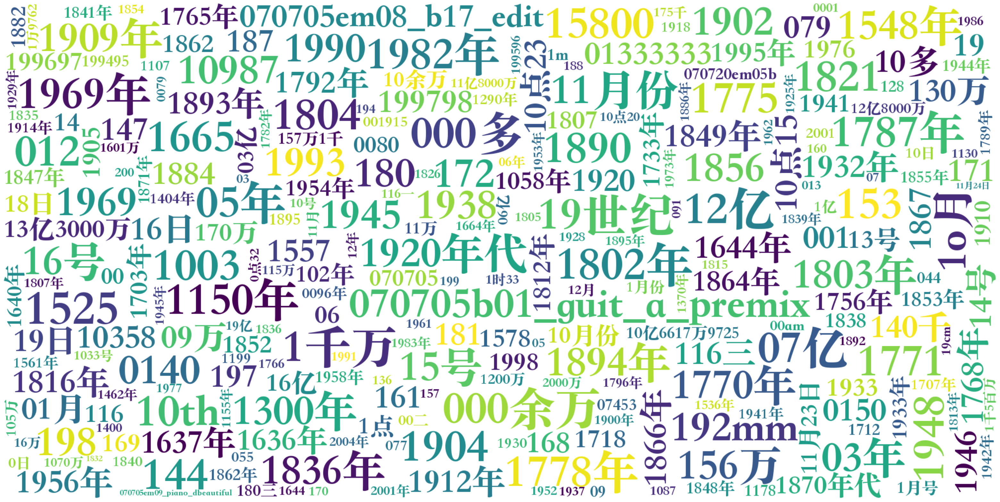

In [46]:
tm.plot_wordcloud(topic_id=5, topK=1000, output_path='../data/task2/topic_5.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))